
# 🎧 Spotify Music Recommendation & Clustering (K-Means, PCA, Visuals)

This notebook loads the SpotifyFeatures dataset and performs:
- Exploratory Data Analysis (EDA)
- K-Means clustering on audio features
- PCA-based visualization
- Interactive plots using Plotly
- Song recommendation based on clusters


In [1]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score, davies_bouldin_score
import plotly.express as px


In [2]:

df = pd.read_csv("SpotifyFeatures.csv")
df.head()


,genre,artist_name,track_name,track_id,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence
0,Movie,Henri Salvador,C'est beau de faire un Show,0BRjO6ga9RKCKjfDqeFgWV,0,0.611,0.389,99373,0.910,0.000,C#,0.3460,-1.828,Major,0.0525,166.969,4/4,0.814
1,Movie,Martin & les fées,Perdu d'avance (par Gad Elmaleh),0BjC1NfoEOOusryehmNudP,1,0.246,0.590,137373,0.737,0.000,F#,0.1510,-5.559,Minor,0.0868,174.003,4/4,0.816
2,Movie,Joseph Williams,Don't Let Me Be Lonely Tonight,0CoSDzoNIKCRs124s9uTVy,3,0.952,0.663,170267,0.131,0.000,C,0.1030,-13.879,Minor,0.0362,99.488,5/4,0.368
3,Movie,Henri Salvador,Dis-moi Monsieur Gordon Cooper,0Gc6TVm52BwZD07Ki6tIvf,0,0.703,0.240,152427,0.326,0.000,C#,0.0985,-12.178,Major,0.0395,171.758,4/4,0.227
4,Movie,Fabien Nataf,Ouverture,0IuslXpMROHdEPvSl1fTQK,4,0.950,0.331,82625,0.225,0.123,F,0.2020,-21.150,Major,0.0456,140.576,4/4,0.390


In [3]:

audio_features = ['acousticness', 'danceability', 'duration_ms', 'energy',
                  'instrumentalness', 'liveness', 'loudness', 'speechiness',
                  'tempo', 'valence']

X = df[audio_features].dropna()
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)


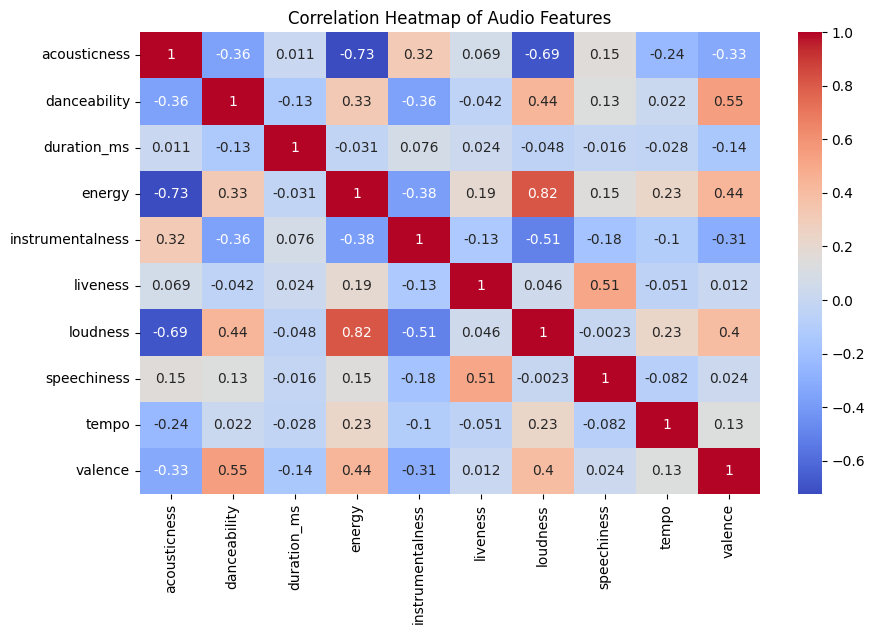

In [4]:

plt.figure(figsize=(10, 6))
sns.heatmap(df[audio_features].corr(), annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap of Audio Features')
plt.show()


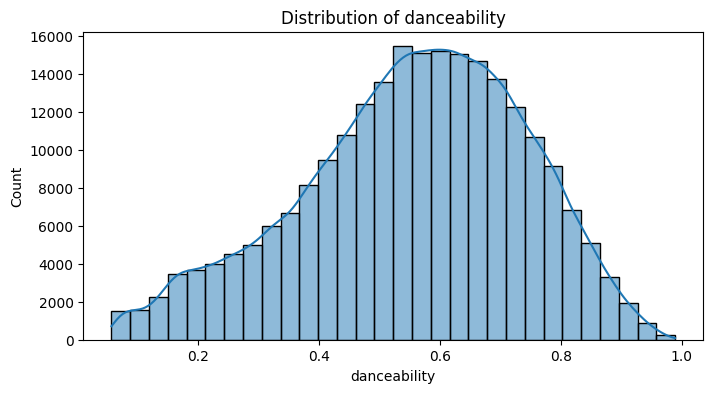

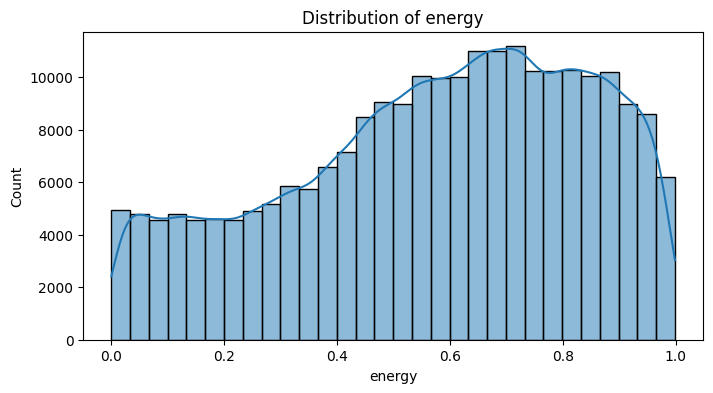

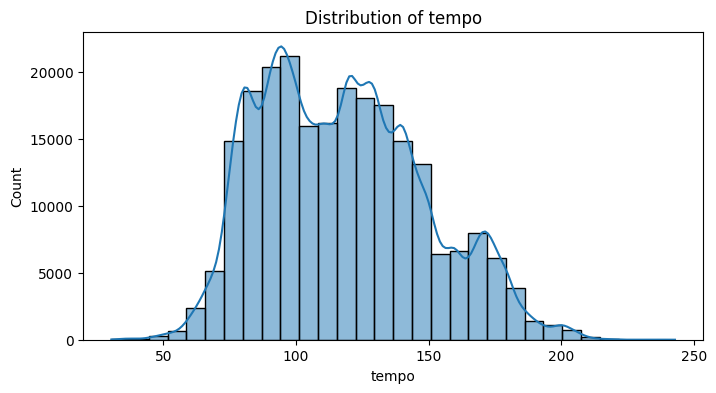

In [5]:

for feature in ['danceability', 'energy', 'tempo']:
    plt.figure(figsize=(8, 4))
    sns.histplot(df[feature], kde=True, bins=30)
    plt.title(f'Distribution of {feature}')
    plt.show()


C:\Users\Abhishek\AppData\Local\Temp\ipykernel_6016\2090562862.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_genres.values, y=top_genres.index, palette='magma')


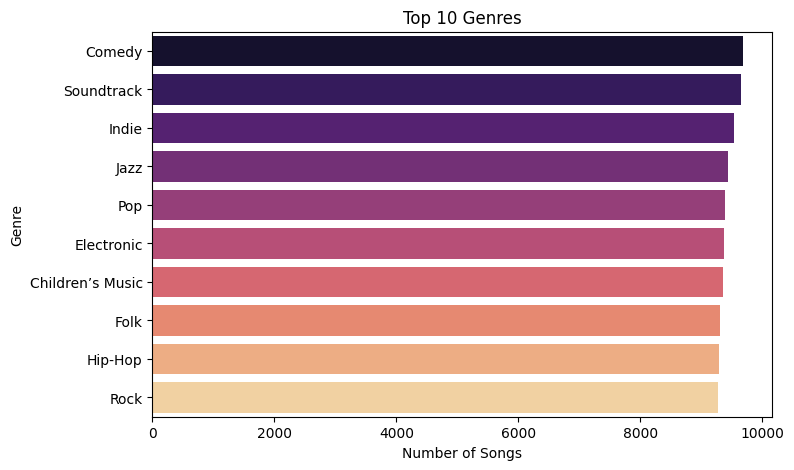

In [6]:

top_genres = df['genre'].value_counts().head(10)
plt.figure(figsize=(8, 5))
sns.barplot(x=top_genres.values, y=top_genres.index, palette='magma')
plt.title('Top 10 Genres')
plt.xlabel('Number of Songs')
plt.ylabel('Genre')
plt.show()


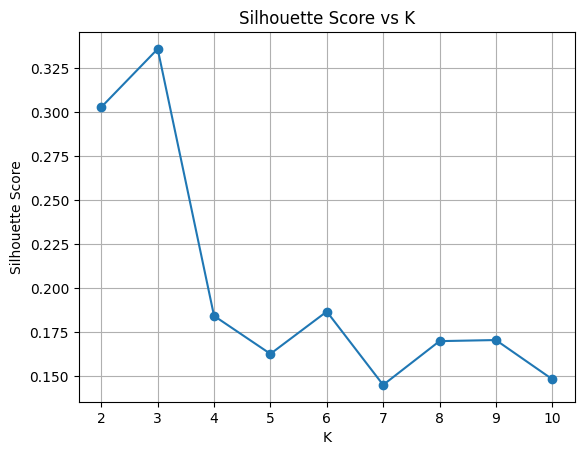

In [7]:

silhouette_scores = []
k_values = range(2, 11)

for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    labels = kmeans.fit_predict(X_scaled)
    score = silhouette_score(X_scaled, labels, sample_size=1000)
    silhouette_scores.append(score)

plt.plot(k_values, silhouette_scores, marker='o')
plt.title('Silhouette Score vs K')
plt.xlabel('K')
plt.ylabel('Silhouette Score')
plt.grid(True)
plt.show()

best_k = k_values[np.argmax(silhouette_scores)]
kmeans = KMeans(n_clusters=best_k, random_state=42)
df['KMeans_Cluster'] = kmeans.fit_predict(X_scaled)


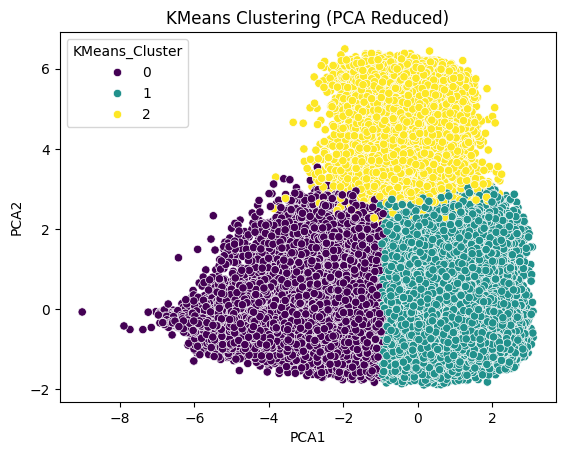

In [8]:

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)
df['PCA1'] = X_pca[:, 0]
df['PCA2'] = X_pca[:, 1]

sns.scatterplot(x='PCA1', y='PCA2', hue='KMeans_Cluster', data=df, palette='viridis')
plt.title('KMeans Clustering (PCA Reduced)')
plt.show()


In [9]:

fig = px.scatter(df, x='PCA1', y='PCA2', color='KMeans_Cluster',
                 hover_data=['track_name', 'artist_name', 'genre'],
                 title='Spotify Songs - KMeans Clustering (Interactive)')
fig.show()


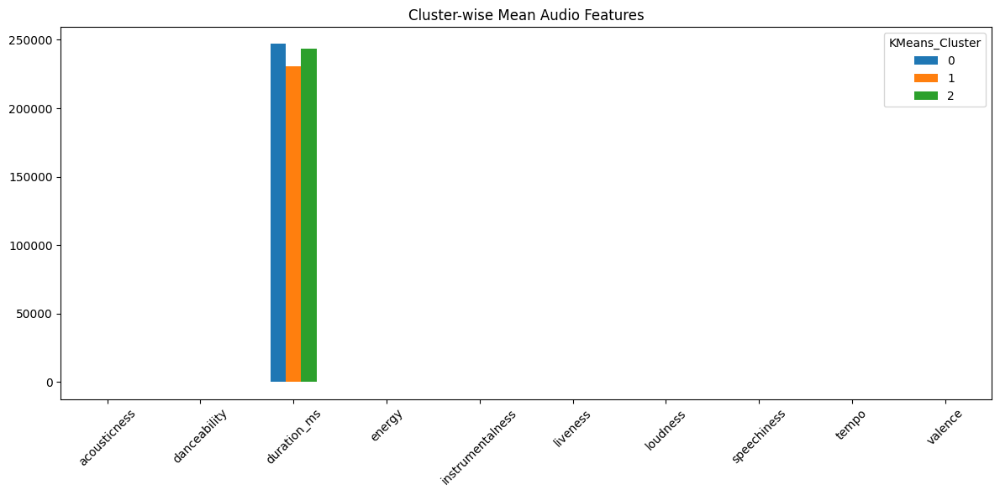

In [10]:

cluster_profile = df.groupby('KMeans_Cluster')[audio_features].mean()
cluster_profile.T.plot(kind='bar', figsize=(12, 6))
plt.title('Cluster-wise Mean Audio Features')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [14]:
def recommend_songs(song_name, model='KMeans_Cluster', n=5):
    index = df[df['track_name'].str.lower() == song_name.lower()].index
    
    # If the song is not found, return random recommendations
    if len(index) == 0:
        print("🎵 Song not found. Showing random popular tracks instead:")
        return df[['track_name', 'artist_name', 'genre']].sample(n)
    
    # Otherwise, return recommendations from same cluster
    index = index[0]
    cluster_label = df.loc[index, model]
    cluster_songs = df[(df[model] == cluster_label) & (df.index != index)]
    
    return cluster_songs[['track_name', 'artist_name', 'genre']].sample(n)
recommend_songs("Some Random Unknown Song", model='KMeans_Cluster', n=5)



🎵 Song not found. Showing random popular tracks instead:


,track_name,artist_name,genre
218128,Changes,Cymande,World
215670,Runnin' Just in Case,Miranda Lambert,Country
13909,Gorgeous,Taylor Swift,Dance
147166,Add the Bassline,Jordan Rakei,Jazz
86189,Every Hour,Tone Stith,R&B
